In [2]:
######
%matplotlib inline
import scanpy as sc
import pandas as pd
import seaborn as sns
import scanpy.external as sce
import os
import numpy as np
######
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
from matplotlib.pyplot import rc_context

from operator import or_
from functools import reduce

mpl.rcParams['pdf.fonttype'] = 42
######
sc.settings.set_figure_params(dpi=80, frameon=True, figsize=(5, 5), facecolor='white')
######
###########other functions
###*****************************calculate mean z score between clusters
import pandas as pd
import numpy as np
#
def grouped_obs_mean(adata, group_key, layer=None, gene_symbols=None):
    if layer is not None:
        getX = lambda x: x.layers[layer]
    else:
        getX = lambda x: x.X
    if gene_symbols is not None:
        new_idx = adata.var[idx]
    else:
        new_idx = adata.var_names
    #
    grouped = adata.obs.groupby(group_key)
    out = pd.DataFrame(
        np.zeros((adata.shape[1], len(grouped)), dtype=np.float64),
        columns=list(grouped.groups.keys()),
        index=adata.var_names
    )
    #
    for group, idx in grouped.indices.items():
        X = getX(adata[idx])
        out[group] = np.ravel(X.mean(axis=0, dtype=np.float64))
    return out
    
###
######***********************avg_heatmap for each cluster
###
## Function for manual scaling and averaging expression per cell type in Heatmap
## Adapted heatmap function from scanpy
from scanpy.plotting._anndata import _plot_categories_as_colorblocks, _prepare_dataframe
from scanpy.plotting._anndata import _reorder_categories_after_dendrogram, _check_var_names_type
from scanpy.plotting._anndata import _plot_dendrogram
from scanpy.plotting._anndata import _plot_categories_as_colorblocks, _plot_colorbar
from matplotlib import gridspec
from matplotlib.colors import ListedColormap, BoundaryNorm
from scipy.stats import zscore

def avg_heatmap(adata, var_names, groupby = None, log = False, use_raw = False, num_categories = 7, order = None,
                gene_symbols = None, var_group_labels = None, var_group_positions = None, layer = None,
                show_gene_labels = None, scale = True, save = None, vmax = None, vmin = None, cmap = "viridis",
                dendrogram = True, colorbar_width = 0.2, categorical = True, figsize = (10, 5), ticksize = 10):

    categories, obs_tidy = _prepare_dataframe(adata, var_names, groupby, use_raw, log, num_categories,
                                                  gene_symbols = gene_symbols, layer = layer)
    var_group_labels = None
    var_group_positions = None
    var_names, var_group_labels, var_group_positions = _check_var_names_type(var_names,
                                                                             var_group_labels, var_group_positions)
    ## Inserted for mean per Cluster
    obs_means = obs_tidy.groupby(groupby).mean()
    
    if scale == True:
        for x in obs_means.columns:
            obs_means[x] = (obs_means[x] - obs_means[x].mean()) / obs_means[x].std()
        
    # get categories colors:
    groupby_colors = adata.uns[groupby + "_colors"]

    # obs_tidy = obs_tidy.sort_index()
    if order is not None:
        obs_means.index = obs_means.index.reorder_categories(order)
    else:
        obs_means = obs_means.sort_index()


    if show_gene_labels is None:
        if len(var_names) <= 50:
            show_gene_labels = True
        else:
            show_gene_labels = False
            #logg.warning(
            print('Gene labels are not shown when more than 50 genes are visualized. '
                 'To show gene labels set `show_gene_labels=True`')

    dendro_height = 0
    groupby_height = 0.13 if categorical else 0
    if figsize is None:
        if show_gene_labels:
            heatmap_height = len(var_names) * 0.18
        else:
            heatmap_height = 4
        width = 10
        height = heatmap_height + dendro_height + groupby_height  # +2 to account for labels
    else:
        width, height = figsize
        heatmap_height = height - (dendro_height + groupby_height)

    height_ratios = [dendro_height, heatmap_height, groupby_height]

    if var_group_positions is not None and len(var_group_positions) > 0:
        # add some space in case 'brackets' want to be plotted on top of the image
        width_ratios = [width, 0.14, colorbar_width]
    else:
        width_ratios = [width, 0, colorbar_width]

    fig = plt.figure(figsize=(width, height))
    axs = gridspec.GridSpec(nrows=3, ncols=3, wspace=0.25 / width,
                            hspace=0.3 / height,
                            width_ratios=width_ratios,
                            height_ratios=height_ratios)

    # plot heatmap
    heatmap_ax = fig.add_subplot(axs[1, 0])

    if order is not None:
        obs_means = obs_means.reindex(order, axis = 0)
    
    im = heatmap_ax.imshow(obs_means.T.values, aspect = 'auto', cmap = cmap, 
                           vmin = vmin, vmax = vmax)#, **kwds)              ## adapted for mean
    heatmap_ax.set_xlim(-0.5, obs_means.shape[0] - 0.5)                     ## adapted for mean
    heatmap_ax.set_ylim(obs_means.shape[1] - 0.5, - 0.5)                    ## adapted for mean

    heatmap_ax.tick_params(axis='x', bottom=False, labelbottom=False)
    heatmap_ax.set_xlabel('')
    heatmap_ax.grid(False)
    if show_gene_labels:
        heatmap_ax.tick_params(axis='y', labelsize='small', length = 1)
        heatmap_ax.set_yticks(np.arange(len(var_names)))
        heatmap_ax.set_yticklabels(var_names, rotation=0, size = ticksize)
        heatmap_ax.set
    else:
        heatmap_ax.tick_params(axis='y', labelleft=False, left=False)

    if categorical:
        groupby_ax = fig.add_subplot(axs[2, 0])
        groupby = obs_means.index.name
        groupby_cmap = ListedColormap(groupby_colors, groupby + '_cmap')
        norm = BoundaryNorm(np.arange(groupby_cmap.N+1)-.5, groupby_cmap.N)

        # determine groupby label positions such that they appear
        # centered next/below to the color code rectangle assigned to the category
        value_sum = -0.5  ## changed from 0
        ticks = []  # list of centered position of the labels
        labels = []
        label2code = {}  # dictionary of numerical values asigned to each label

        for code, (label, value) in enumerate(obs_means.index.value_counts(sort = False).iteritems()):
        
            ticks.append(value_sum + (value / 2))
            labels.append(label)
            value_sum += value
            label2code[label] = code
        groupby_ax.grid(False)

        groupby_ax.imshow(np.matrix([label2code[lab] for lab in obs_means.index]), aspect='auto', 
                          cmap = groupby_cmap, norm = norm)
        if len(labels) > 1:
            groupby_ax.set_xticks(ticks)
            if max([len(x) for x in labels]) < 3:
                # if the labels are small do not rotate them
                rotation = 0
            else:
                rotation = 90
            groupby_ax.set_xticklabels(labels, rotation=rotation)

        # remove x ticks, y ticks and labels
        groupby_ax.tick_params(axis='x', bottom = False, labelsize = ticksize)
        groupby_ax.tick_params(axis='y', left = False, labelleft = False)

        # remove surrounding lines
        groupby_ax.spines['right'].set_visible(False)
        groupby_ax.spines['top'].set_visible(False)
        groupby_ax.spines['left'].set_visible(False)
        groupby_ax.spines['bottom'].set_visible(False)

        groupby_ax.set_xlabel(groupby)

        # add lines to main heatmap
        line_positions = np.cumsum(obs_means.index.value_counts(sort=False))[:-1]
        heatmap_ax.vlines(line_positions - 0.505, -1, len(var_names) + 1, lw = 1)
    

    # plot colorbar
    _plot_colorbar(im, fig, axs[1, 2])
    
    #plt.show()
    plt.savefig(save)
    #plt.close()

#
def Barplot(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var], normalize='index') * 100
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
    ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_perc'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
                       dpi=300, orientation='landscape', format= 'pdf', optimize=True)
    
def Barplot_abs(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var])
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = False, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = False, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
    ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_abs'+var+'_proportions_'+which_var+'.pdf', bbox_inches='tight',
                       dpi=300, orientation='landscape', format= 'pdf', optimize=True)
    
    
    
def Barplot2(which_var, adata, var='clusters', height=3, color = False):
    plotdata = pd.crosstab(adata.obs[var], adata.obs[which_var])
    if 'category' in plotdata.index.dtype.name:
        plotdata.index.reorder_categories(adata.obs[var].cat.categories[::-1])

    if not color:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False)
    else:
        ax1 = plotdata.plot.barh(stacked = True, edgecolor = 'none', zorder = 3, figsize = (6,height), fontsize = 14, grid = False, color = color)
    ax1.set_title(which_var+' %')
    ax1.set_ylabel(var)
    horiz_offset = 1
    vert_offset = 1.
    ax1 = ax1.legend(bbox_to_anchor = (horiz_offset, vert_offset))
    ax1.figure.savefig(str(sc.settings.figdir)+'/barplot_'+var+'_proportions_abs_'+which_var+'.pdf', bbox_inches='tight',
                       dpi=300, orientation='landscape', format= 'pdf', optimize=True)
    

In [3]:
#####color setting
my_color20= [ "#F3C300", "#875692", "#F38400", "#A1CAF1", "#BE0032" ,"#C2B280" ,"#848482" ,"#008856" ,
             "#E68FAC", "#0067A5" ,"#F99379" ,"#604E97" ,"#F6A600" ,"#B3446C" ,"#DCD300", "#882D17",
 "#8DB600" ,"#654522" ,"#E25822" ,"#2B3D26"]

my_color24=["#7F3C8DFF", '#11A579FF',  '#3969ACFF',  '#F2B701FF',  '#E73F74FF', '#80BA5AFF', '#E68310FF', '#008695FF', 
           '#CF1C90FF', '#F97B72FF', '#4B4B8FFF',  '#A5AA99FF','#B2DF8AFF',  '#33A02CFF',  '#FB9A99FF',  '#E31A1CFF',
           '#FDBF6FFF', '#FF7F00FF',  '#CAB2D6FF',  '#6A3D9AFF',  '#FFFF99FF',  '#B15928FF', '#A6CEE3FF', '#1F78B4FF'

]

my_color36 = ['#E5D2DD', '#53A85F', '#F1BB72', '#F3B1A0', '#D6E7A3', '#57C3F3', '#476D87', '#E95C59', '#E59CC4',
 '#AB3282', '#23452F', '#BD956A', '#8C549C', '#585658', '#9FA3A8', '#E0D4CA', '#5F3D69', '#C5DEBA', '#58A4C3', 
'#E4C755', '#F7F398', '#AA9A59', '#E63863', '#E39A35', '#C1E6F3', '#6778AE', '#91D0BE', '#B53E2B', '#712820', 
'#DCC1DD', '#CCE0F5',  '#CCC9E6', '#625D9E', '#68A180', '#3A6963', '#968175']

In [4]:
### set directory
tar= './result/Tcell/'
outfig = tar+'/outfig' +'/'
outdata =tar+'/outdata' +'/'

print(outfig)
print(outdata)

d = os.path.dirname(outfig)
if not os.path.exists(d):
        os.makedirs(d)

d = os.path.dirname(outdata)
if not os.path.exists(d):
        os.makedirs(d)
#####
sc.settings.figdir=outfig
###

./result/Tcell//outfig/
./result/Tcell//outdata/


In [5]:
adata=sc.read('../result/s3_01_Tcell_02_scanpy_based_anno/outdata/adata_s2_all_filter_degs_annotated_clean.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 38994 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sampleID', 'pMT', 'pHB', 'pRP', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'CC.Difference', 'Doublet', 'scrublet_Score', 'scrublet_predict', 'scrublet_score_overclustered', 'is_doublet_overclustered', 'ident', 'louvain', 'ICBresponse', 'metagenomeID', 'cell_type_main', 'predicted_labels', 'majority_voting', 'conf_score', 'celltypist_Immune_All_High_voting', 'over_clustering', 'celltypist_Immune_All_low_voting', 'ICBresponse2', 'louvain_subtype', 'cytotoxic_score', 'exhausted_score', 'NK_score', 'gdlt_Tcell', 'CD4T', 'CD8T', 'T_prolif', 'CD8_Naive_CD8_C01_LEF1', 'CD8_TcM_CD8_C02_GPR183', 'CD8_TEMRA.TEFF_CD8_C03_CX3CR1', 'CD8_TEM_CD8_C04_GZMK', 'CD8_TRM_CD8_C05_CD6', 'CD8_IEL_CD8_CO6_CD160', 'CD8_TEX_CD8_C07_LAYN', 'CD8_MAIT_CD8_C08_SLC4A10', 'CD4_Naive_CD4_C01_CCR7', 'CD4_Blood_TcM_CD4_C02_ANXA1', 'CD4_TEMA.TEFF_CD4_CO3_GNLY', 'CD4_Normal_TcM_CD4_C04_TCF7', 'CD4_TRM_CD4_C05_CXCR6'

In [7]:
adata=adata[adata.obs['sampleID'].isin(['GC6' ,  'mGC2' ,  'mGC3'  , 'mGC4'  , 'mGC5' ,'PD1GC1'])]

In [46]:
RFhigh=['mGC2','mGC4','mGC5','PD1GC1']
adata.obs['RFgroup'] = np.where( adata.obs['sampleID'].isin(RFhigh), 'RFhigh', 'RFlow')

In [9]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=50,use_rep='X_pca_harmonized'
               )
sc.tl.umap(adata)

2023-03-08 21:51:56.386845: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2023-03-08 21:51:56.386874: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2


In [17]:
sc.tl.louvain(adata,resolution=1.5, key_added='louvain_subtype2') 

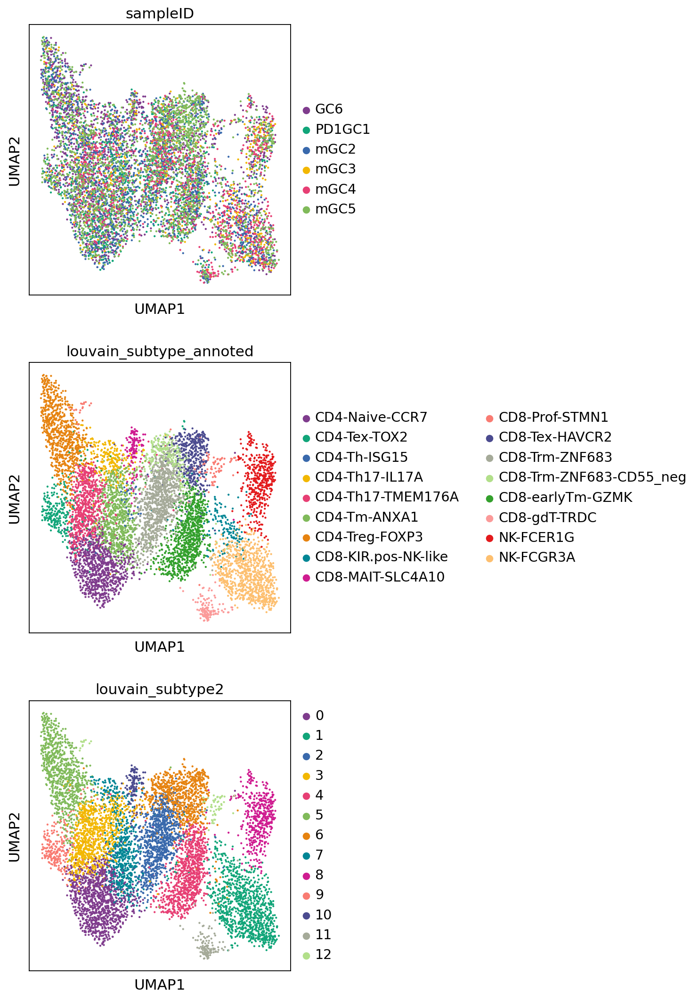

In [18]:
myvars= ['sampleID','louvain_subtype_annoted','louvain_subtype2'
        ]
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,
           #wspace=0.5,hspace=0.5,
               ncols=1#,save= tar_cellname+'_clean_s3_cell_type_main2_annotated.pdf'
              )


In [29]:
pd.crosstab(index= adata.obs['louvain_subtype2'], columns= adata.obs['louvain_subtype_annoted'])

louvain_subtype_annoted,CD4-Naive-CCR7,CD4-Tex-TOX2,CD4-Th-ISG15,CD4-Th17-IL17A,CD4-Th17-TMEM176A,CD4-Tm-ANXA1,CD4-Treg-FOXP3,CD8-KIR.pos-NK-like,CD8-MAIT-SLC4A10,CD8-Prof-STMN1,CD8-Tex-HAVCR2,CD8-Trm-ZNF683,CD8-Trm-ZNF683-CD55_neg,CD8-earlyTm-GZMK,CD8-gdT-TRDC,NK-FCER1G,NK-FCGR3A
louvain_subtype2,,,,,,,,,,,,,,,,,
0,836,26,3,1,75,132,5,0,0,0,0,12,0,1,0,0,0
1,0,0,0,0,0,1,0,117,1,0,0,11,1,8,6,10,842
2,2,0,0,0,1,6,0,10,1,6,9,910,0,1,0,0,0
3,9,11,1,61,617,204,7,0,1,0,0,1,4,2,0,1,1
4,0,0,2,0,0,3,0,8,0,0,18,13,5,833,0,0,0
5,1,5,0,19,24,2,781,0,0,9,1,0,0,1,0,0,0
6,0,4,0,5,7,3,2,4,0,8,375,103,264,8,0,1,4
7,16,2,35,130,4,425,0,0,9,0,1,18,0,1,0,0,0
8,0,0,0,0,0,0,0,7,0,6,1,1,0,0,0,434,0


In [39]:
cluster_dict={'CD4-Th-ISG15':'CD4-Tm-ANXA1',
              'CD4-Th17-TMEM176A':'CD4-Tm-ANXA1',
              'CD8-KIR.pos-NK-like':'NK-FCGR3A',
              'CD8-Trm-ZNF683-CD55_neg':'CD8-Trm-ZNF683'
             }
#####
adata.obs['louvain_subtype_annoted_clean'] = (
    adata.obs["louvain_subtype_annoted"]
    .map(lambda x: cluster_dict.get(x, x))
    .astype("category")
)

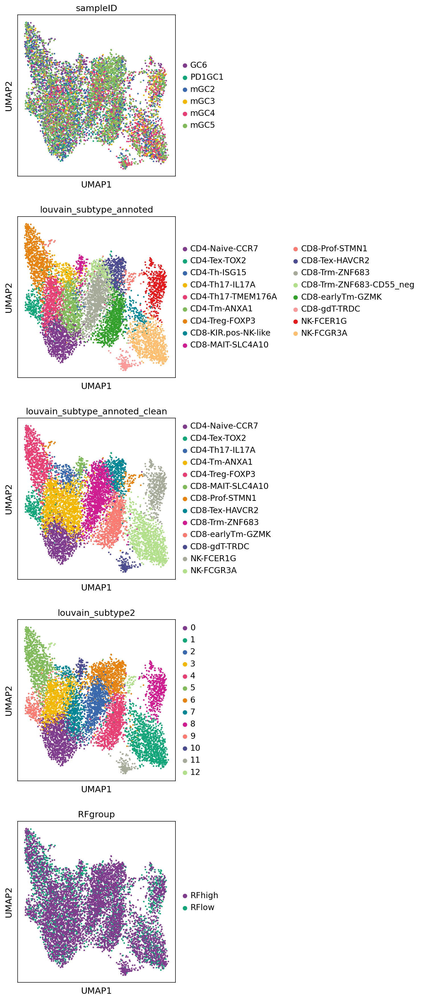

In [8]:
myvars= ['sampleID','louvain_subtype_annoted','louvain_subtype_annoted_clean','louvain_subtype2','RFgroup'
        ]
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,size=25,
           #wspace=0.5,hspace=0.5,
               ncols=1,save= '_clean_cell_type_annotated2.pdf'
              )

/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:220: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error in 3.6


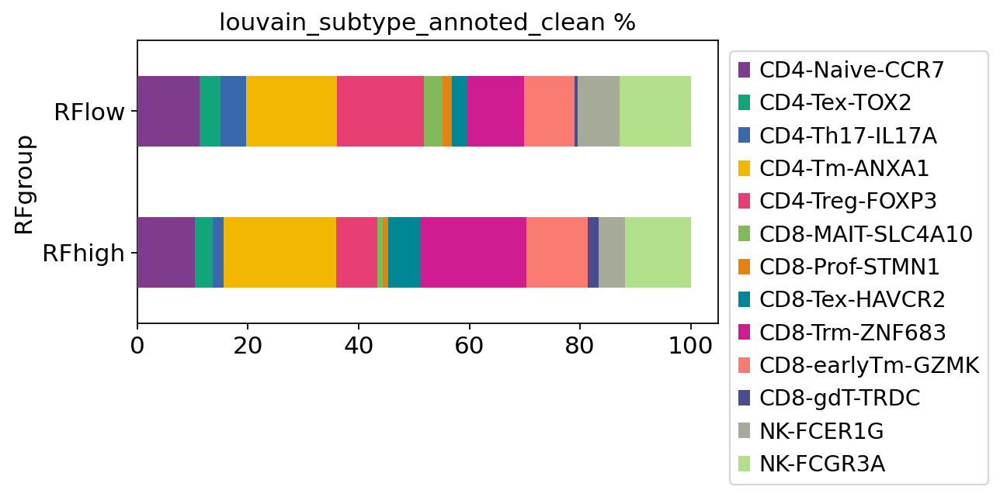

In [49]:
Barplot(adata= adata,which_var='louvain_subtype_annoted_clean', var='RFgroup', height=3,color=my_color24
       )

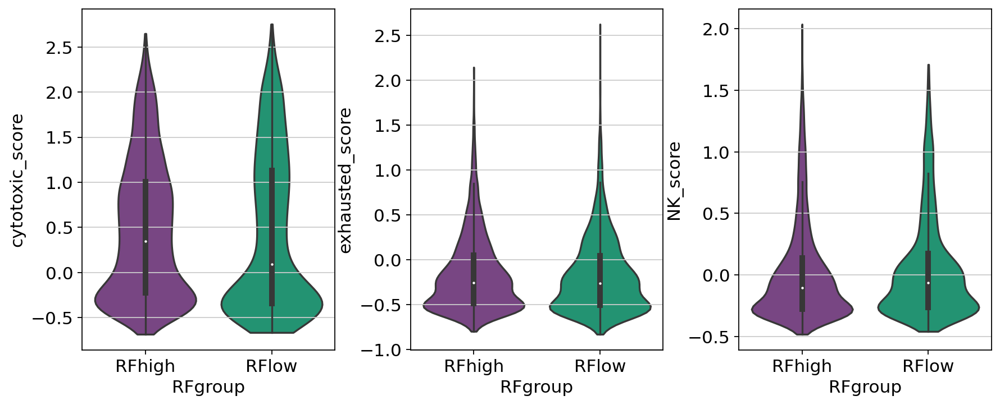

In [54]:
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.violin(adata,
                 ['cytotoxic_score','exhausted_score','NK_score'], 
                 groupby='RFgroup', stripplot=False, inner='box',save='_box_TNK.pdf'
                )  # use stripplot=False to remove the internal dots, inner='box' adds a boxplot inside violins


In [55]:
save_file = outdata+ 'adata_Tcell_6GCs.h5ad'
adata.write_h5ad(save_file)

In [5]:
adata=sc.read(outdata+ 'adata_Tcell_6GCs.h5ad')

In [58]:
adata.obs.to_csv(outdata+ 'adata_Tcell_6GCs.csv')

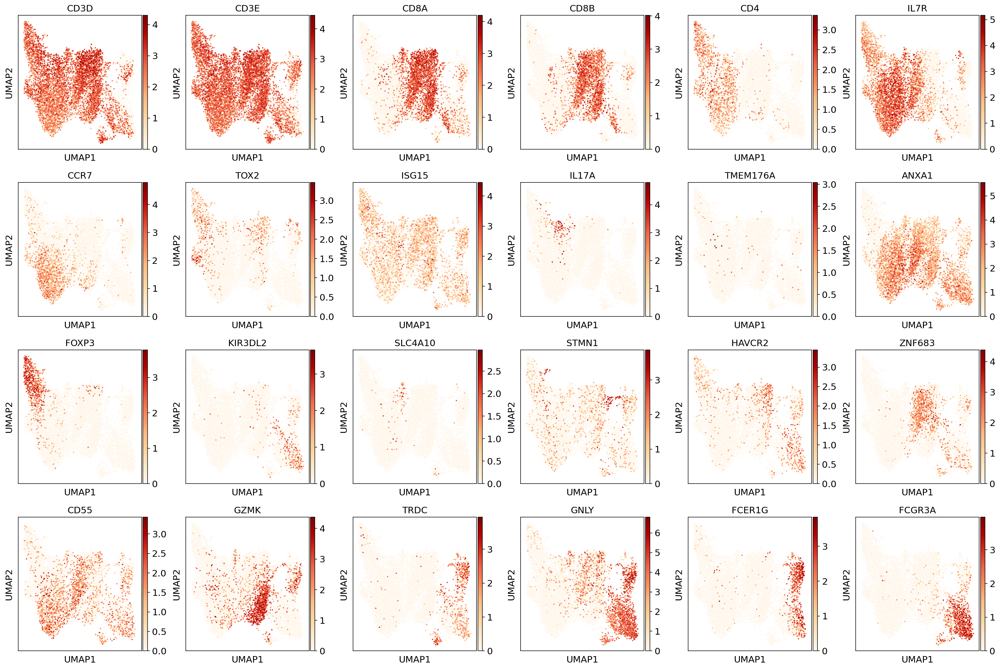

In [27]:
marker_genes =['CD3D','CD3E','CD8A','CD8B','CD4','IL7R',
               'CCR7','TOX2','ISG15','IL17A','TMEM176A','ANXA1',
               'FOXP3','KIR3DL2','SLC4A10','STMN1','HAVCR2','ZNF683',
               'CD55','GZMK','TRDC','GNLY','FCER1G','FCGR3A'
              ]
with rc_context({'figure.figsize': (3.5, 4)}):
    sc.pl.umap(adata, color=marker_genes,#hspace=0.5,wspace=0.5,
               ncols=6,
          
           color_map= 'OrRd',save='_clean_Tcell_marker.pdf'
          )  

In [42]:
### degs using COSG pipeline
import cosg as cosg
import importlib
importlib.reload(cosg)

cosg.cosg(adata,
    key_added='cosg',use_raw=True,remove_lowly_expressed=True,expressed_pct=0.1,
        mu=1,
        n_genes_user=500,
               groupby='louvain_subtype_annoted_clean')

**finished identifying marker genes by COSG**


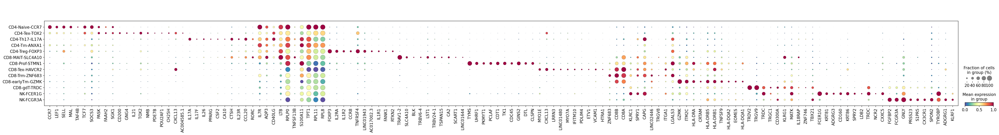

In [43]:
sc.tl.dendrogram(adata,groupby='louvain_subtype_annoted_clean')

df_tmp=pd.DataFrame(adata.uns['cosg']['names'][:10,]).T
df_tmp.reindex(adata.obs['louvain_subtype_annoted_clean'].cat.categories)
marker_genes_list=np.ravel(df_tmp.reindex(adata.obs['louvain_subtype_annoted_clean'].cat.categories))
sc.pl.dotplot(adata, marker_genes_list,
             groupby='louvain_subtype_annoted_clean',              
             dendrogram=False,
             standard_scale='var',
             cmap='Spectral_r', 
              save= '_s2_cosg_top_degs_louvain_subtype_annoted_clean.pdf'
             )

In [44]:
pd.DataFrame(adata.uns['cosg']['names'][:500,]).T.to_csv(outdata+ 's2_cosg_top500.genes.csv')

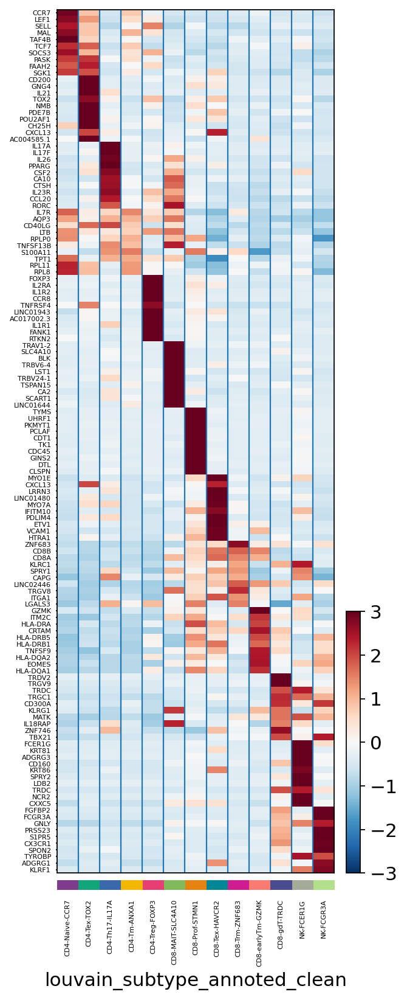

In [45]:
avg_heatmap(adata, var_names = marker_genes_list, 
            groupby = "louvain_subtype_annoted_clean", ticksize = 5, figsize = (4,12),
            dendrogram = True,scale = True, use_raw = True, show_gene_labels = True, vmax = 3, vmin = -3, #cmap = "bwr", 
cmap='RdBu_r', save= outfig+'_s2_heatmap_cosg_top_degs_louvain_subtype_annoted_clean.pdf')

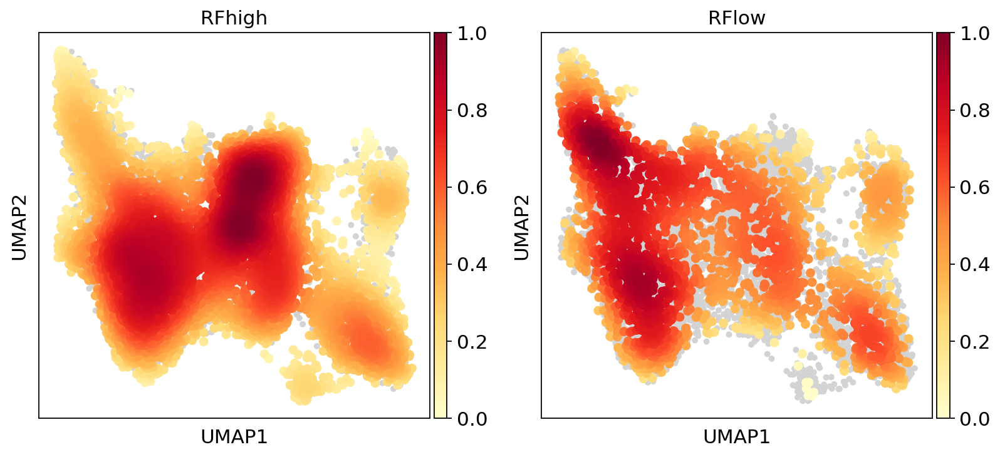

In [105]:
sc.tl.embedding_density(adata, basis='umap', groupby='RFgroup')
sc.pl.embedding_density(adata, basis='umap', key='umap_density_RFgroup',save= '_s1_Tcell_density.pdf')

# MAC

In [4]:
### set directory
tar= './result/Mac/'
outfig = tar+'/outfig' +'/'
outdata =tar+'/outdata' +'/'

print(outfig)
print(outdata)

d = os.path.dirname(outfig)
if not os.path.exists(d):
        os.makedirs(d)

d = os.path.dirname(outdata)
if not os.path.exists(d):
        os.makedirs(d)
#####
sc.settings.figdir=outfig
###

./result/Mac//outfig/
./result/Mac//outdata/


In [66]:
adata=sc.read('../result/s4_01_Myeloid_01_scanpy_based_anno/outdata/adata_s2_all_filter_degs_annotated.h5ad')

In [67]:
adata=adata[adata.obs['sampleID'].isin(['GC6' ,  'mGC2' ,  'mGC3'  , 'mGC4'  , 'mGC5' ,'PD1GC1'])].copy()

In [68]:
RFhigh=['mGC2','mGC4','mGC5','PD1GC1']
adata.obs['RFgroup'] = np.where( adata.obs['sampleID'].isin(RFhigh), 'RFhigh', 'RFlow')

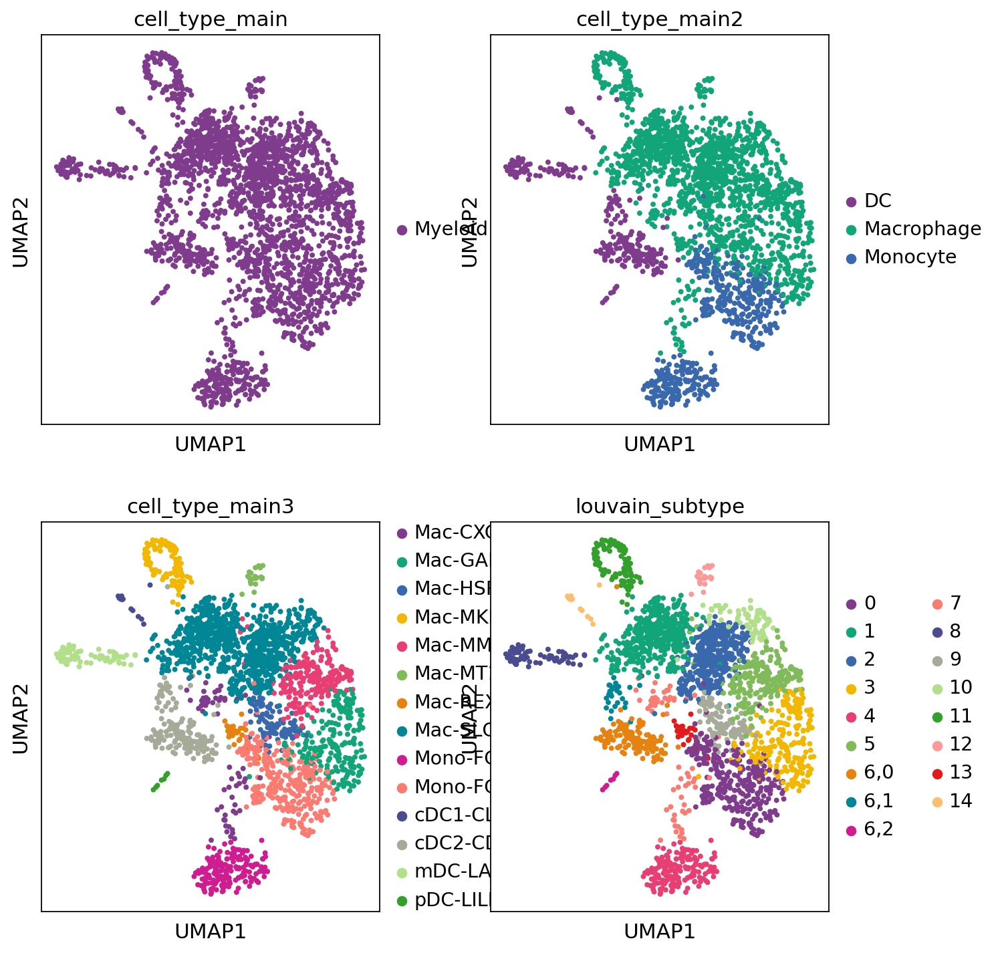

In [69]:
myvars= ['cell_type_main','cell_type_main2','cell_type_main3','louvain_subtype'
        ]
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,
           #wspace=0.5,hspace=0.5,
               ncols=2#,
           #save= tar_cellname+'_s2_cell_type_main3.pdf'
              )

In [63]:
adata

AnnData object with n_obs × n_vars = 2356 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sampleID', 'pMT', 'pHB', 'pRP', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'CC.Difference', 'Doublet', 'scrublet_Score', 'scrublet_predict', 'scrublet_score_overclustered', 'is_doublet_overclustered', 'ident', 'louvain', 'ICBresponse', 'metagenomeID', 'cell_type_main', 'predicted_labels', 'majority_voting', 'conf_score', 'celltypist_Immune_All_High_voting', 'over_clustering', 'celltypist_Immune_All_low_voting', 'ICBresponse2', 'louvain_subtype', 'cell_type_main2', 'cell_type_main3', 'M1', 'M2', 'Angiogenesis', 'Phagocytosis', 'ActivatedDC', 'MigratoryDC', 'HALLMARK_INFLAMMATORY_RESPONSE', 'KEGG_ANTIGEN_PROCESSING_AND_PRESENTATION', 'KEGG_VASCULAR_SMOOTH_MUSCLE_CONTRACTION', 'HALLMARK_ANGIOGENESIS', 'REACTOME_COLLAGEN_FORMATION', 'M1 Macrophage Polarization_Azizi', 'M2 Macrophage Polarization_Azizi', 'M1_cibersort', 'M2_cibersort', 'RFgroup'
    var: 'highly_variable', 'means', 'di

In [70]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=50,use_rep='X_pca_harmonized'
               )
sc.tl.umap(adata)

In [8]:
sc.tl.louvain(adata,resolution=1, key_added='louvain_subtype2') 

In [36]:
#sc.tl.louvain(adata, restrict_to=('louvain_subtype2', ['3']), 
#              resolution=0.4, key_added='louvain_subtype_tmp')

In [39]:
#with rc_context({'figure.figsize': (5, 5)}):
#    sc.pl.umap(adata, color=['louvain_subtype_tmp'],legend_loc='on data',
#           palette= my_color24,
               #wspace=0.5,hspace=0.5,
#               ncols=1#, save= '_s2_louvain_ondata.pdf'
#          )

In [20]:
cluster_dict={'0':'Mac',
              '1':'Mac',
              '2':'Mono-FCN1',
              '3':'Mono-FCN1',
              '4':'Mac',
              '5':'Mono-FCGR3B',
              '6':'cDC2-CD1C',
              '7':'Mac',
              '8':'mDC-LAMP3'
             }
#####
adata.obs['cell_type_clean'] = (
    adata.obs["louvain_subtype2"]
    .map(lambda x: cluster_dict.get(x, x))
    .astype("category")
)

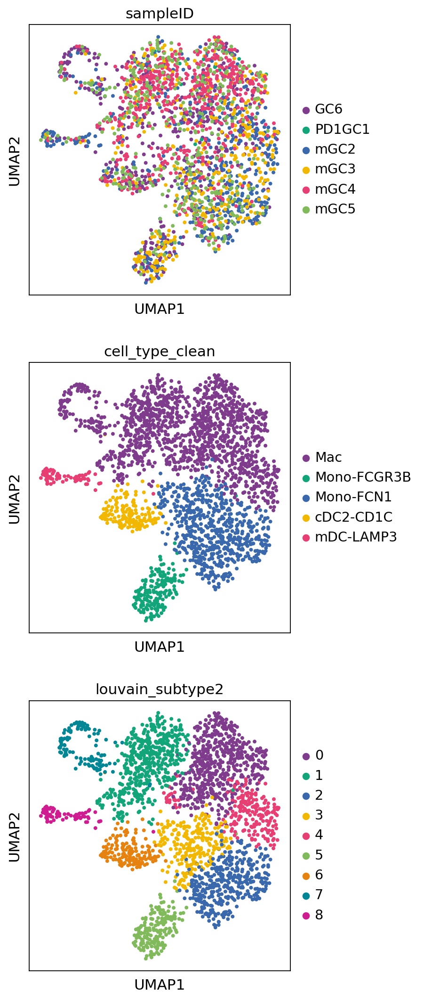

In [29]:
myvars= ['sampleID','cell_type_clean','louvain_subtype2'
        ]
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,
           #wspace=0.5,hspace=0.5,
               ncols=1,
           save= '_s2_Mye_type_main3.pdf'
              )

/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:220: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error in 3.6


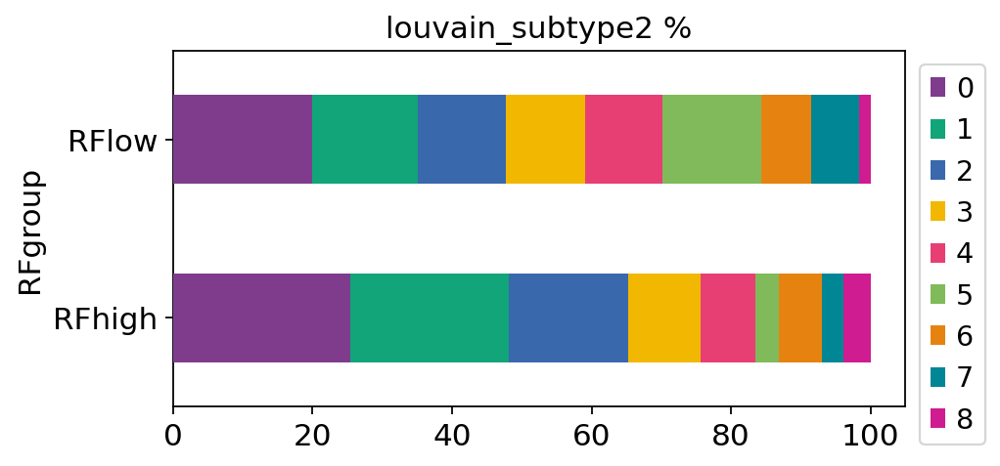

In [30]:
Barplot(adata= adata,which_var='louvain_subtype2', var='RFgroup', height=3,color=my_color24
       )

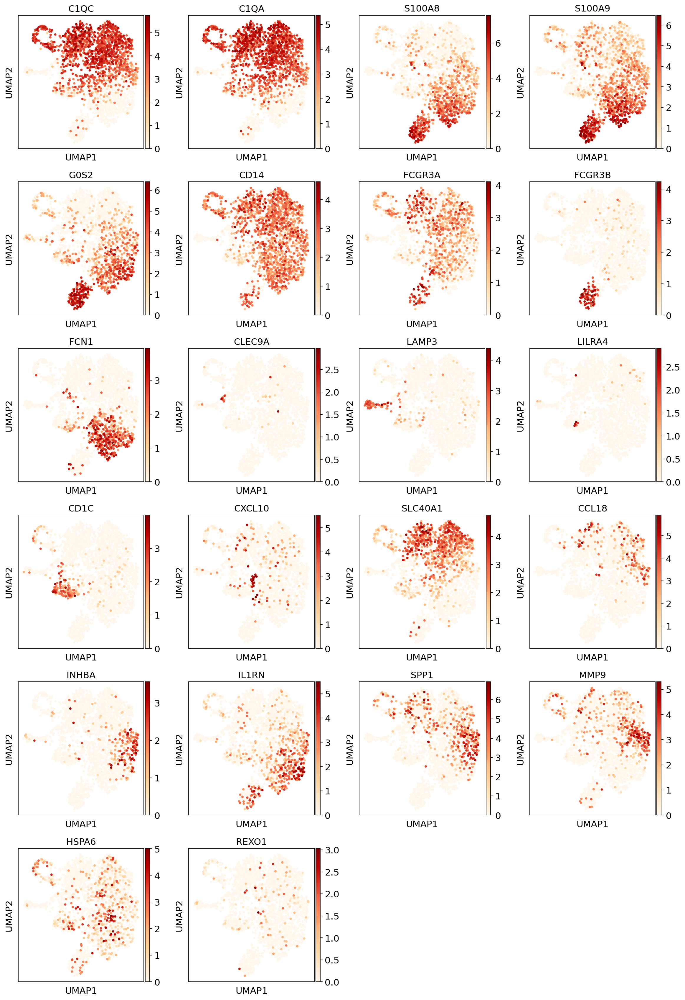

In [7]:
marker_genes =['C1QC','C1QA','S100A8','S100A9','G0S2','CD14','FCGR3A','FCGR3B','FCN1',
               'CLEC9A','LAMP3','LILRA4','CD1C','CXCL10','SLC40A1','CCL18','INHBA','IL1RN','SPP1','MMP9','HSPA6','REXO1'
              ]
with rc_context({'figure.figsize': (3.5, 4)}):
    sc.pl.umap(adata, color=marker_genes,#hspace=0.5,wspace=0.5,
               ncols=4,
           #size=10,
           color_map= 'OrRd',save='_s2_Mye_marker.pdf'
          )  

In [41]:
adata

AnnData object with n_obs × n_vars = 2356 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sampleID', 'pMT', 'pHB', 'pRP', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'CC.Difference', 'Doublet', 'scrublet_Score', 'scrublet_predict', 'scrublet_score_overclustered', 'is_doublet_overclustered', 'ident', 'louvain', 'ICBresponse', 'metagenomeID', 'cell_type_main', 'predicted_labels', 'majority_voting', 'conf_score', 'celltypist_Immune_All_High_voting', 'over_clustering', 'celltypist_Immune_All_low_voting', 'ICBresponse2', 'louvain_subtype', 'cell_type_main2', 'cell_type_main3', 'M1', 'M2', 'Angiogenesis', 'Phagocytosis', 'ActivatedDC', 'MigratoryDC', 'HALLMARK_INFLAMMATORY_RESPONSE', 'KEGG_ANTIGEN_PROCESSING_AND_PRESENTATION', 'KEGG_VASCULAR_SMOOTH_MUSCLE_CONTRACTION', 'HALLMARK_ANGIOGENESIS', 'REACTOME_COLLAGEN_FORMATION', 'M1 Macrophage Polarization_Azizi', 'M2 Macrophage Polarization_Azizi', 'M1_cibersort', 'M2_cibersort', 'RFgroup', 'louvain_subtype2', 'louvain_subtype_an

In [44]:
#######rename cluster based on function
cluster_dict={'0':'Mac-SLC40A1',
              '1':'Mac-SLC40A1',
              '2':'Mono-FCN1',
              '3':'Mono-FCN1',
              '4':'Mac-MMP9', 
              '5':'Mono-FCGR3B',
              '6':'DC-CD1C',
              '7':'Mac-MKi67',
              '8':'DC-LAMP3'
             }
#####
adata.obs['louvain_subtype_annoted_clean'] = (
    adata.obs["louvain_subtype2"]
    .map(lambda x: cluster_dict.get(x, x))
    .astype("category")
)

In [51]:
cluster_dict={'0':'Mac',
              '1':'Mac',
              '2':'Mono',
              '3':'Mono',
              '4':'Mac',
              '5':'Mono',
              '6':'DC',
              '7':'Mac',
              '8':'DC'
             }
#####
adata.obs['cell_type_clean2'] = (
    adata.obs["louvain_subtype2"]
    .map(lambda x: cluster_dict.get(x, x))
    .astype("category")
)

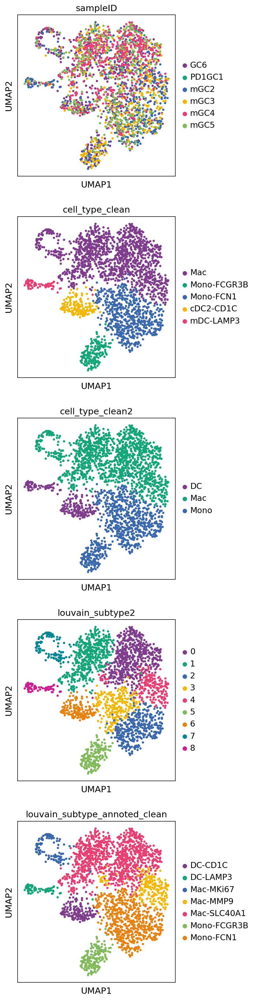

In [52]:
myvars= ['sampleID','cell_type_clean','cell_type_clean2','louvain_subtype2','louvain_subtype_annoted_clean'
        ]
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,
           #wspace=0.5,hspace=0.5,
               ncols=1,
           save= '_s2_Mye_type_main3.pdf'
              )

/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:220: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error in 3.6


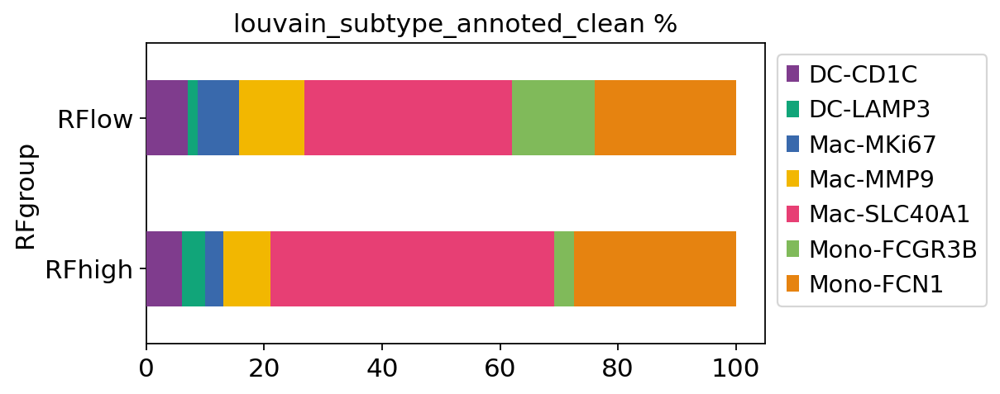

In [49]:
Barplot(adata= adata,which_var='louvain_subtype_annoted_clean', var='RFgroup', height=3,color=my_color24
       )

/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:220: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error in 3.6


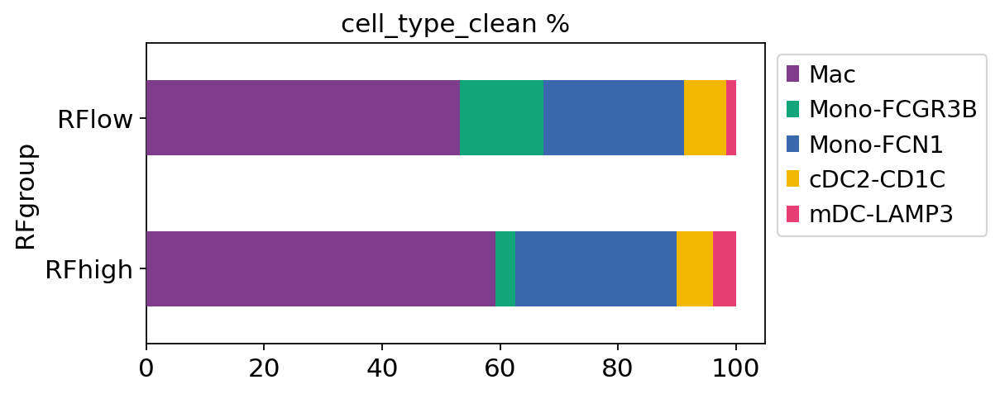

In [50]:
Barplot(adata= adata,which_var='cell_type_clean', var='RFgroup', height=3,color=my_color24
       )

/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:220: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "optimize" which is no longer supported as of 3.3 and will become an error in 3.6


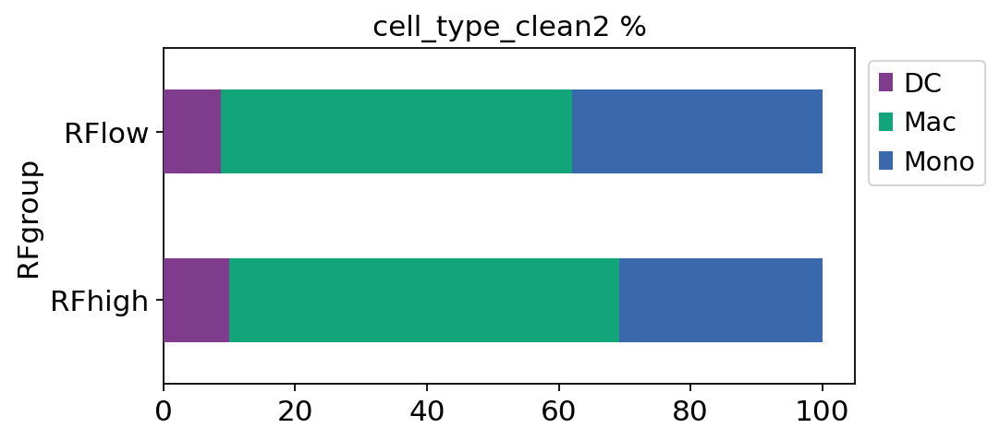

In [53]:
Barplot(adata= adata,which_var='cell_type_clean2', var='RFgroup', height=3,color=my_color24
       )

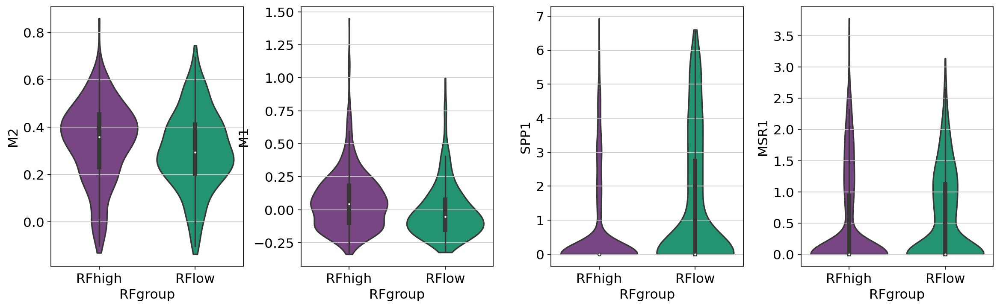

In [48]:
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.violin(adata[adata.obs['louvain_subtype_annoted_clean'].str.contains('Mac')].copy(),
                 ['M2','M1','SPP1','MSR1'], 
                 groupby='RFgroup', stripplot=False, inner='box',save='_box_Mac.pdf'
                )  # use stripplot=False to remove the internal dots, inner='box' adds a boxplot inside violins


In [54]:
save_file = outdata+ 'adata_Mye_6GCs.h5ad'
adata.write_h5ad(save_file)

In [55]:
adata.obs.to_csv(outdata+ 'adata_obs_Mye_6GCs.csv')

In [5]:
adata=sc.read(outdata+ 'adata_Mye_6GCs.h5ad')

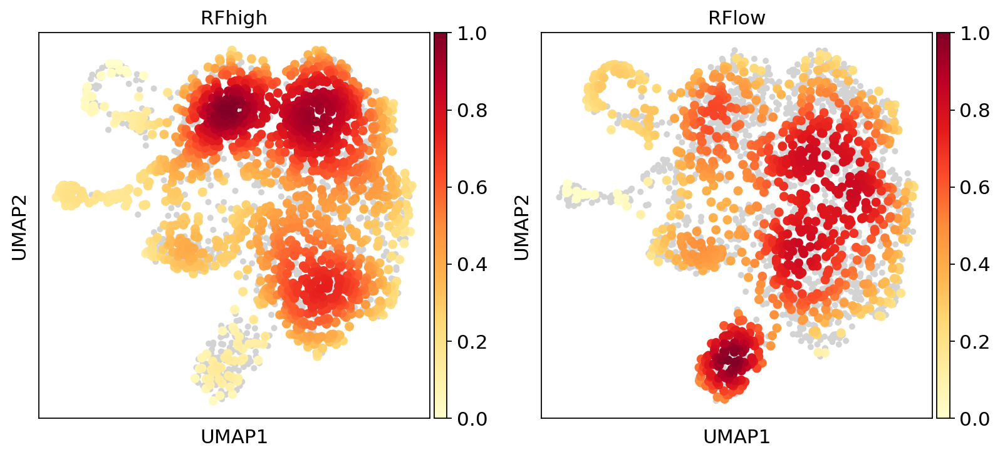

In [108]:
sc.tl.embedding_density(adata, basis='umap', groupby='RFgroup')
sc.pl.embedding_density(adata, basis='umap', key='umap_density_RFgroup',save= '_s1_Mye_density.pdf')

# all cell analysis

In [4]:
### set directory
tar= './result/total/'
outfig = tar+'/outfig' +'/'
outdata =tar+'/outdata' +'/'

print(outfig)
print(outdata)

d = os.path.dirname(outfig)
if not os.path.exists(d):
        os.makedirs(d)

d = os.path.dirname(outdata)
if not os.path.exists(d):
        os.makedirs(d)
#####
sc.settings.figdir=outfig
###

./result/total//outfig/
./result/total//outdata/


In [83]:
adata=sc.read('../result/s1_04_01_global_annotation/outdata/adata_louvain_annotated_celltypist.h5ad')

In [84]:
adata=adata[adata.obs['sampleID'].isin(['GC6' ,  'mGC2' ,  'mGC3'  , 'mGC4'  , 'mGC5' ,'PD1GC1'])].copy()

In [85]:
RFhigh=['mGC2','mGC4','mGC5','PD1GC1']
adata.obs['RFgroup'] = np.where( adata.obs['sampleID'].isin(RFhigh), 'RFhigh', 'RFlow')

In [81]:
#adata=adata[~adata.obs['louvain'].isin(['23'])].copy()

In [90]:
sc.tl.pca(adata, svd_solver='arpack')
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=50,use_rep='X_pca_harmonized'
               )
sc.tl.umap(adata)

In [96]:
save_file = outdata+'adata_louvain_annotated_6GCs.h5ad'
adata.write_h5ad(save_file)

In [77]:
adata

AnnData object with n_obs × n_vars = 24376 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sampleID', 'pMT', 'pHB', 'pRP', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'CC.Difference', 'Doublet', 'scrublet_Score', 'scrublet_predict', 'scrublet_score_overclustered', 'is_doublet_overclustered', 'ident', 'louvain', 'ICBresponse', 'metagenomeID', 'cell_type_main', 'predicted_labels', 'majority_voting', 'conf_score', 'celltypist_Immune_All_High_voting', 'over_clustering', 'celltypist_Immune_All_low_voting', 'ICBresponse2', 'RFgroup'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'X_name', 'cell_type_main_colors', 'celltypist_Immune_All_High_voting_colors', 'celltypist_Immune_All_low_voting_colors', 'dendrogram_cell_type_main', 'dendrogram_louvain', 'hvg', 'leiden', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'sampleID_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmonized', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logc

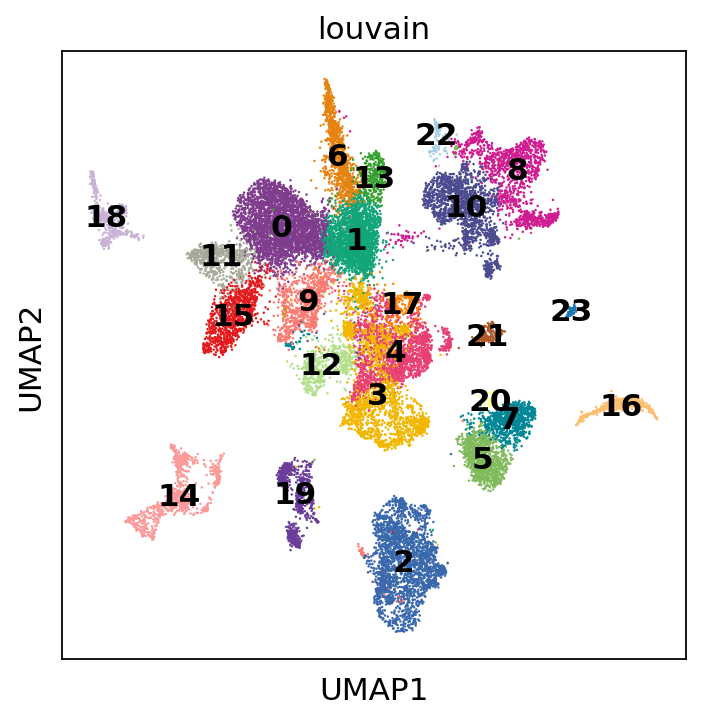

In [92]:
myvars=['louvain']

with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,legend_loc='on data',
           #wspace=0.5,hspace=0.5,
               ncols=1#,
           #save='_s7_cell_mainlineage_anno.pdf'
              )

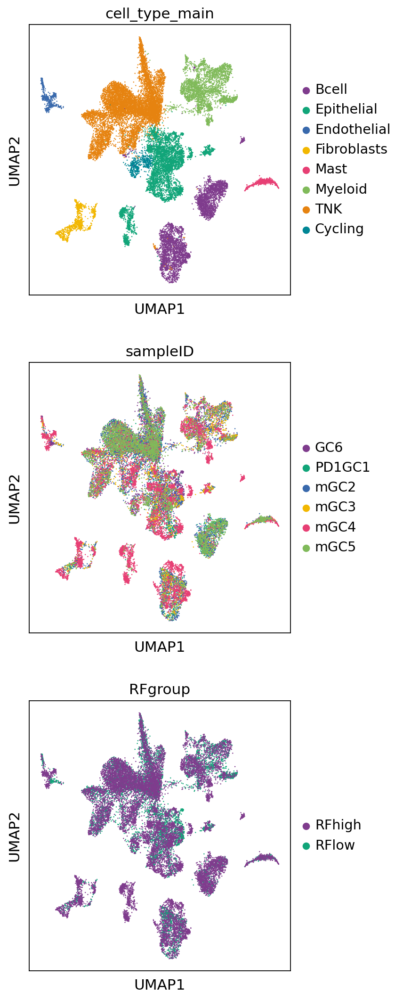

In [93]:
myvars=['cell_type_main','sampleID','RFgroup']

with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= my_color24,
           #wspace=0.5,hspace=0.5,
               ncols=1,
           save='_s7_cell_mainlineage_anno.pdf'
              )

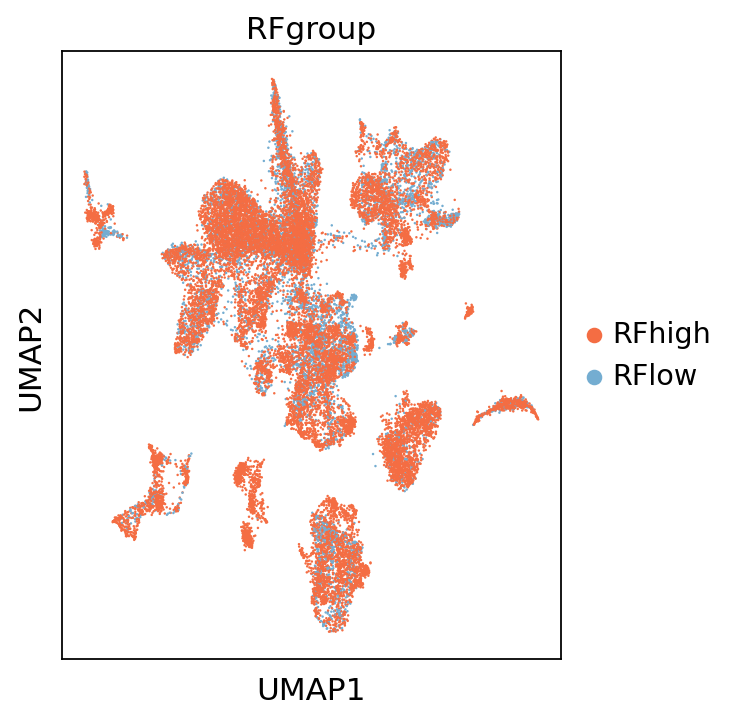

In [98]:
myvars=['RFgroup']

with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=myvars,palette= ["#f46d43","#74add1"],
           #wspace=0.5,hspace=0.5,
               ncols=1,
           save='_s7_cell_mainlineage_anno_RFgroup.pdf'
              )

In [101]:
sc.tl.embedding_density(adata, basis='umap', groupby='RFgroup')

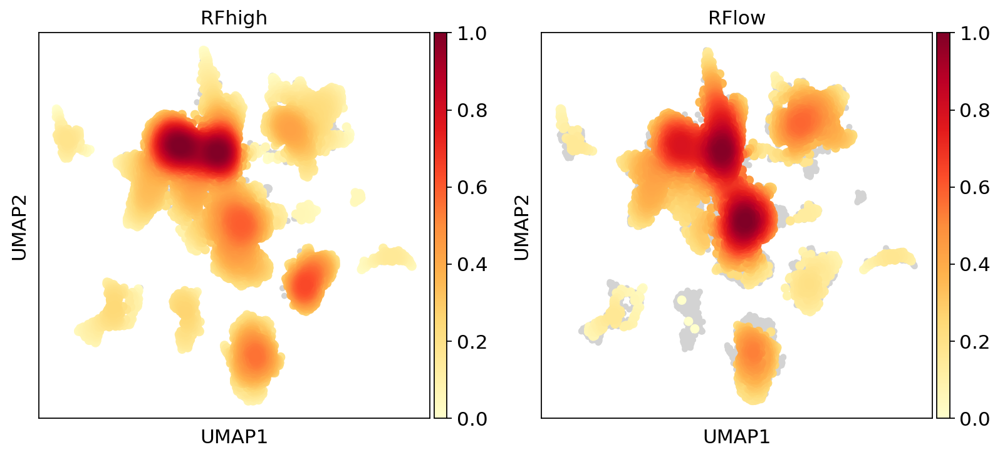

In [102]:
sc.pl.embedding_density(adata, basis='umap', key='umap_density_RFgroup',save= '_s1_density.pdf')

/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:22: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
/home/chenh/.local/lib/python3.7/site-packages/ipykernel_launcher.py:46: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.


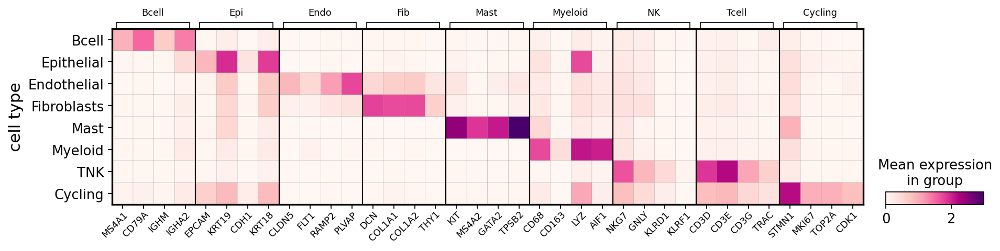

In [67]:
###########******************
dict_c = {
    'Bcell': ['MS4A1','CD79A', 'IGHM', 'IGHA2'],
    'Epi': ['EPCAM', 'KRT19', 'CDH1', 'KRT18'],
    'Endo':['CLDN5', 'FLT1', 'RAMP2', 'PLVAP'],
    'Fib': ['DCN', 'COL1A1', 'COL1A2', 'THY1'],
    'Mast': ['KIT', 'MS4A2','GATA2','TPSB2'],
    'Myeloid': ['CD68', 'CD163', 'LYZ','AIF1'],
    'NK': [ 'NKG7', 'GNLY', 'KLRD1', 'KLRF1'],
    'Tcell': ['CD3D', 'CD3E', 'CD3G', 'TRAC'],
    'Cycling':['STMN1', 'MKI67', 'TOP2A', 'CDK1']
}
adata.obs['cell_type_main'].cat.reorder_categories(
    ['Bcell',
    'Epithelial',
    'Endothelial',
    'Fibroblasts',
    'Mast',
    'Myeloid',
    'TNK',
    'Cycling'
], inplace=True)

cg = sc.pl.matrixplot(
    adata, 
    dict_c, use_raw=False, groupby="cell_type_main", 
    #var_group_labels=var_group_labels, var_group_positions=var_group_positions,
    var_group_rotation=0, #dendrogram=True,
    cmap="RdPu", vmin=0, vmax=3,
    show=False, figsize=(13, 3)
)
fig = plt.gcf()
axs = fig.get_axes()
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=45, ha="right", size=8, va="top", rotation_mode="anchor");
axs[0].tick_params(axis="x", pad=1)
axs[0].set_ylabel("cell type")
for y in range(4, 36, 4):
    axs[0].axvline(y, lw=1, color="k")
axs[2].set_ylabel("Log Normalized UMIs")
for child in axs[1].get_children():
    if isinstance(child, mpl.text.Text):
        child.set_fontsize(8)
    elif isinstance(child, mpl.patches.PathPatch):
        child.set_linewidth(0.75)
fig.subplots_adjust(right=0.9, left=0.1, bottom=0.2, top=0.9)
fig.tight_layout(rect=(0.05, 0.05, 0.95, 0.95))
plt.savefig(outfig+'s6_global_marker_scale_cell_type_main.pdf')

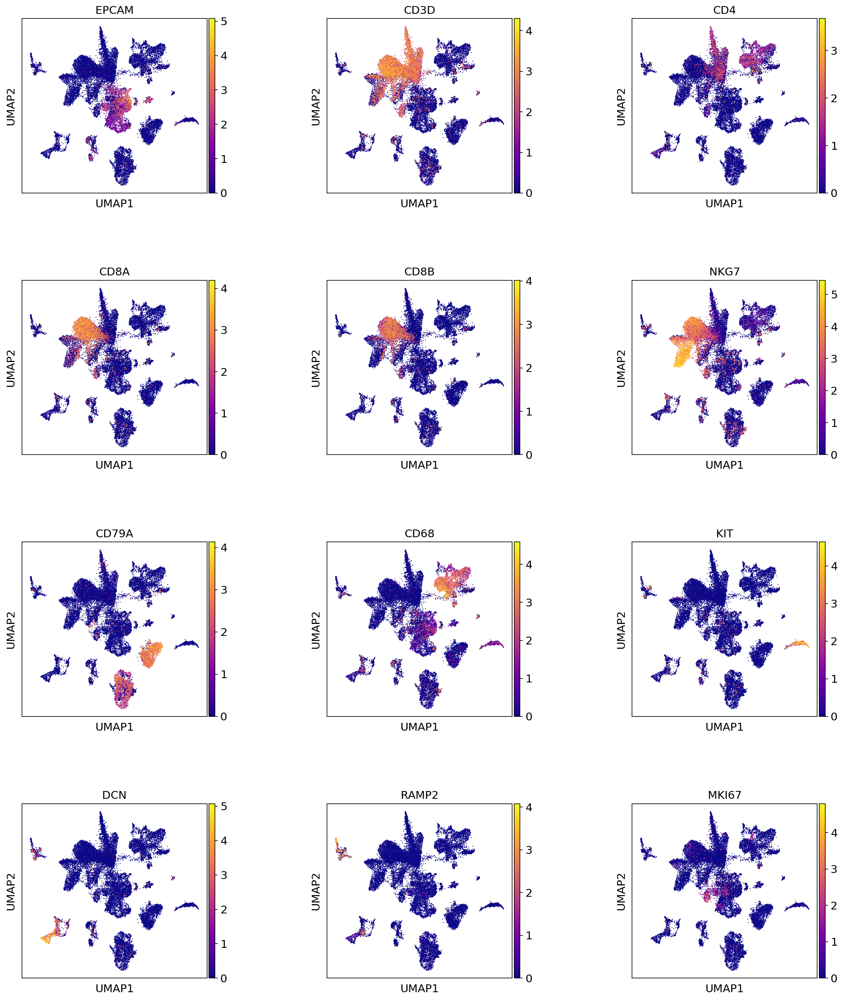

In [94]:
marker_genes = ['EPCAM','CD3D','CD4','CD8A','CD8B','NKG7','CD79A','CD68','KIT','DCN','RAMP2','MKI67'
                 ]
with rc_context({'figure.figsize': (4, 5)}):
    sc.pl.umap(adata, color=marker_genes,hspace=0.5,wspace=0.5,ncols=3 ,
           color_map= 'plasma',
           save='_s4_global_markers.pdf')
#

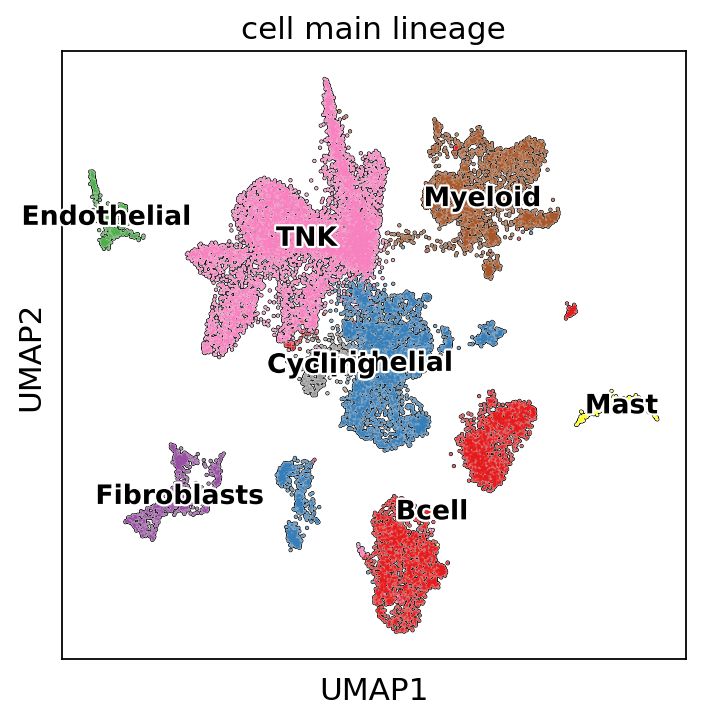

In [95]:
with rc_context({'figure.figsize': (5, 5)}):
    sc.pl.umap(adata, color='cell_type_main', add_outline=True, legend_loc='on data',
               legend_fontsize=12, legend_fontoutline=2,frameon=True,
               title='cell main lineage', palette='Set1',save='umap_cell_main.pdf'
              )

In [5]:
###
###write out files for upload to public database
###
adata=sc.read(outdata+'adata_louvain_annotated_6GCs.h5ad')

In [6]:
adata

AnnData object with n_obs × n_vars = 24376 × 33538
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'sampleID', 'pMT', 'pHB', 'pRP', 'S.Score', 'G2M.Score', 'Phase', 'old.ident', 'CC.Difference', 'Doublet', 'scrublet_Score', 'scrublet_predict', 'scrublet_score_overclustered', 'is_doublet_overclustered', 'ident', 'louvain', 'ICBresponse', 'metagenomeID', 'cell_type_main', 'predicted_labels', 'majority_voting', 'conf_score', 'celltypist_Immune_All_High_voting', 'over_clustering', 'celltypist_Immune_All_low_voting', 'ICBresponse2', 'RFgroup'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'RFgroup_colors', 'X_name', 'cell_type_main_colors', 'celltypist_Immune_All_High_voting_colors', 'celltypist_Immune_All_low_voting_colors', 'dendrogram_cell_type_main', 'dendrogram_louvain', 'hvg', 'leiden', 'louvain', 'louvain_colors', 'neighbors', 'pca', 'sampleID_colors', 'umap'
    obsm: 'X_pca', 'X_pca_harmonized', 'X_umap'
    varm: 'PCs'
    layer

In [7]:
adata.obs['sampleID'].value_counts()

mGC4      7241
GC6       4588
mGC5      4281
mGC2      3884
PD1GC1    2411
mGC3      1971
Name: sampleID, dtype: int64

In [8]:
adata.layers['counts'].toarray()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]], dtype=float32)

In [14]:
t=adata.layers['counts'].toarray()
pd.DataFrame(data=t, index=adata.obs_names, columns=adata.raw.var_names).to_csv(outdata+'adata_raw_counts_6GCs.csv')

In [15]:
adata.obs.to_csv(outdata+'adata_raw_counts_6GCs_obsdata.csv')

In [11]:
adata.layers['counts']

<24376x33538 sparse matrix of type '<class 'numpy.float32'>'
	with 33205203 stored elements in Compressed Sparse Column format>

In [12]:
import scipy.sparse as sparse
import scipy.io as sio
import scipy.stats as stats
import numpy as np

In [13]:
sparse_matrix=adata.layers['counts']
sio.mmwrite(outdata+"adata_raw_counts_6GCs_sparse_matrix.mtx",sparse_matrix)

In [ ]:
adata